In [1]:
import cv2
import numpy as np
import glob
import random
import os
from google.colab.patches import cv2_imshow


In [2]:
# Load Yolo
net = cv2.dnn.readNet("drive/MyDrive/ObjectDetection/yolov3_training_last.weights", "drive/MyDrive/ObjectDetection/yolov3_testing.cfg")


In [5]:
colors

array([[166.24497107,  65.97404347, 102.03700804]])

In [9]:

# Name custom object
classes = ["Waldo"]

# Images path
base_path = '/content/drive/MyDrive/ObjectDetection/WALDOFINAL/'
images_path = os.listdir(base_path)



layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# Insert here the path of your images
random.shuffle(images_path)


In [19]:
len(os.listdir(base_path))

72

()
()
0
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


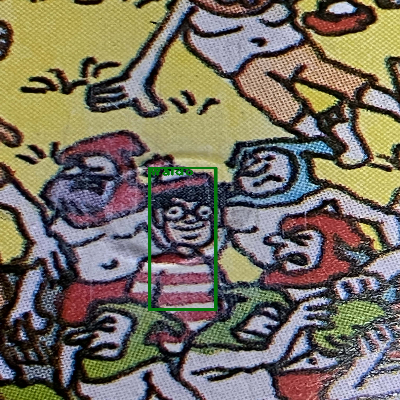

IMG_8960.jpg
(1613, 1210, 3)


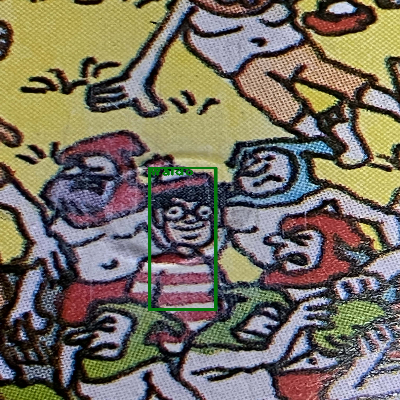

()
0
()
IMG_8945.jpg
(1613, 1210, 3)


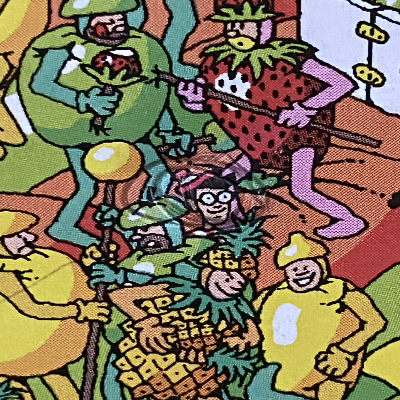

()
()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


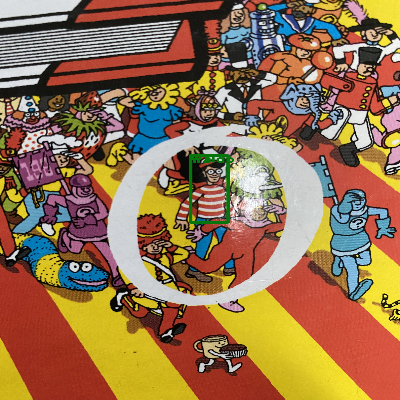

0
()
IMG_8945.jpg
(1613, 1210, 3)


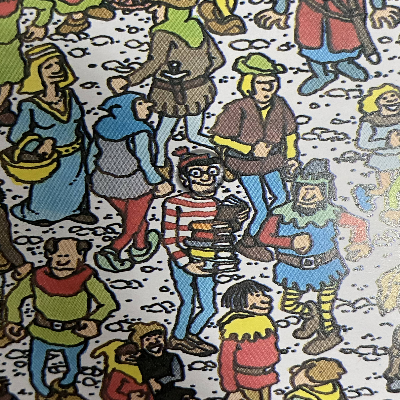

()
()
()
()
0
[0]
IMG_8945.jpg
(1210, 1613, 3)


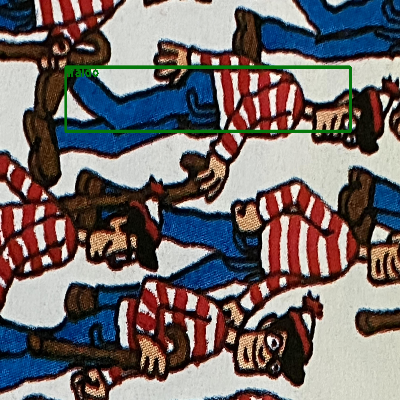

()
()
0
0
()
IMG_8945.jpg
(1613, 1210, 3)


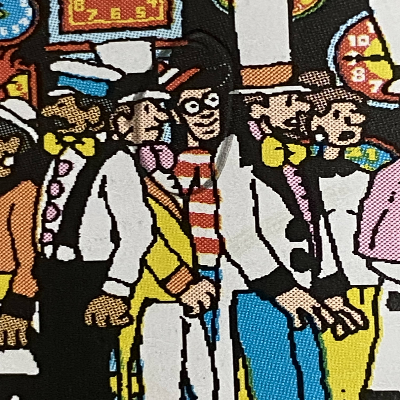

IMG_8960.jpg
(1613, 1210, 3)


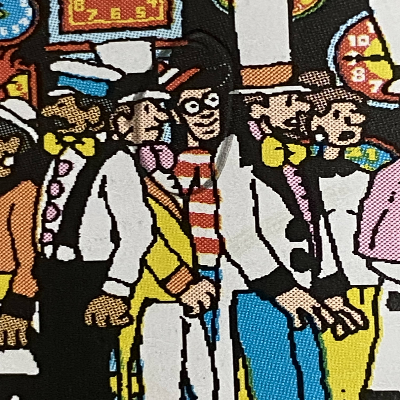

0
0
[1]
IMG_8945.jpg
(1613, 1210, 3)


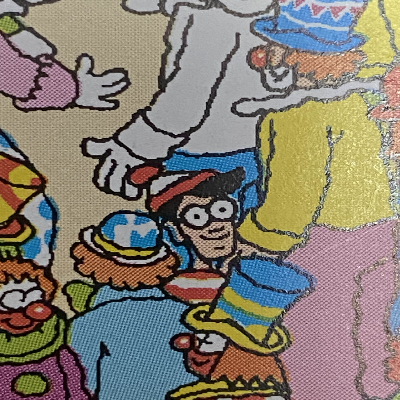

IMG_8960.jpg
(1613, 1210, 3)


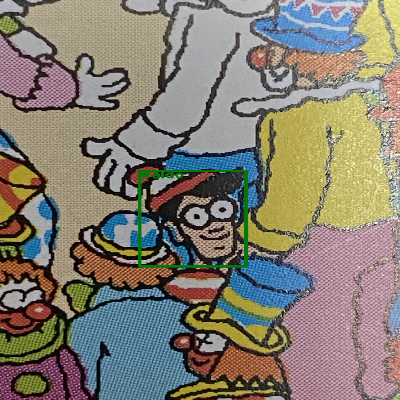

()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


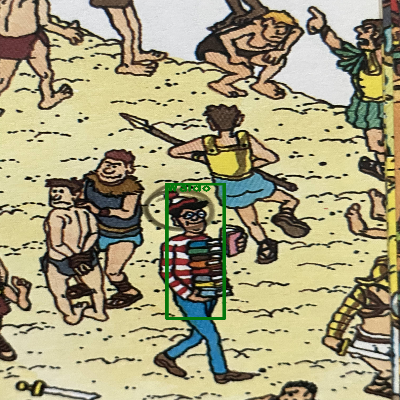

0
[0]
IMG_8945.jpg
(1613, 1210, 3)


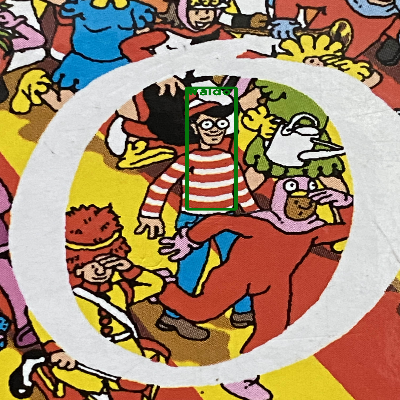

()
()
0
0
[0]
IMG_8945.jpg
(1210, 1613, 3)


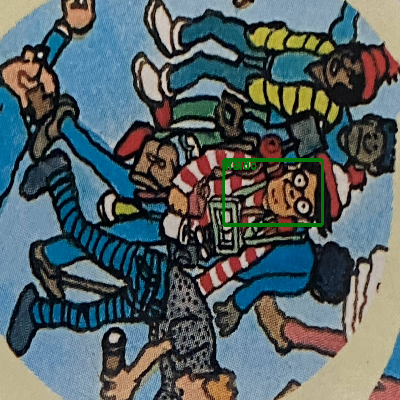

IMG_8960.jpg
(1210, 1613, 3)


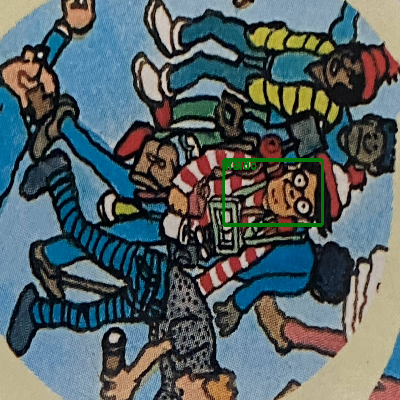

()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


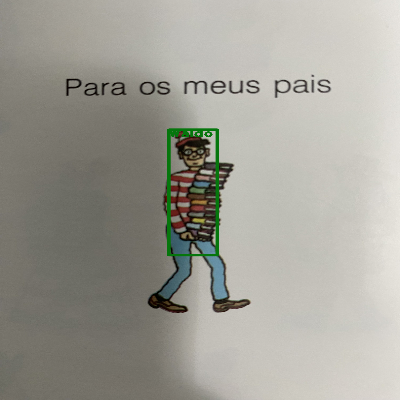

()
()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


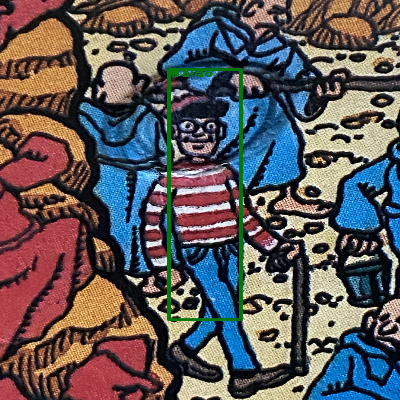

0
[0]
IMG_8945.jpg
(1210, 1613, 3)


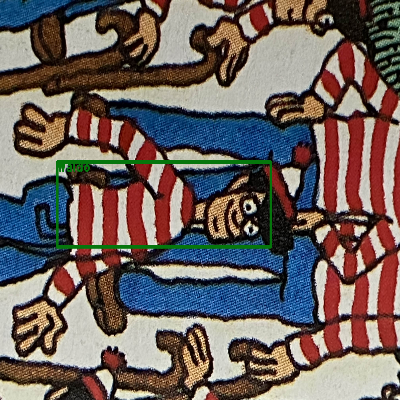

0
0
()
IMG_8945.jpg
(1613, 1210, 3)


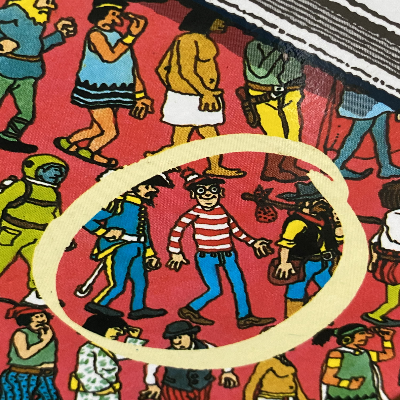

IMG_8960.jpg
(1613, 1210, 3)


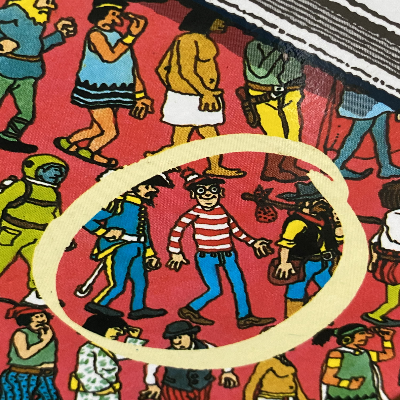

()
()
0
[0]
IMG_8945.jpg
(1210, 1613, 3)


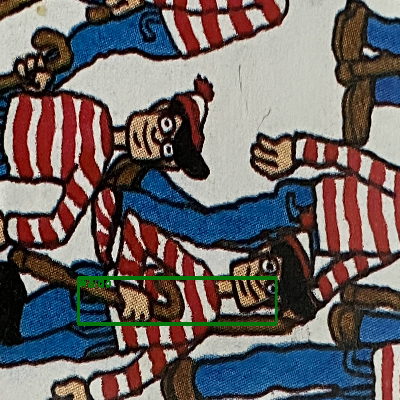

()
()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


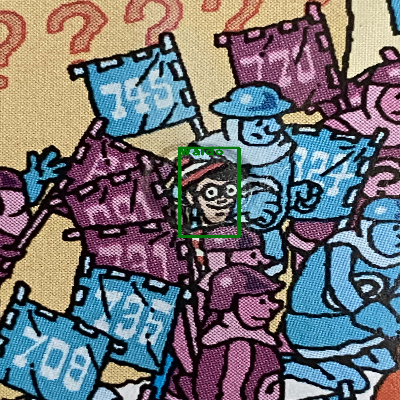

0
0
[1]
IMG_8945.jpg
(1613, 1210, 3)


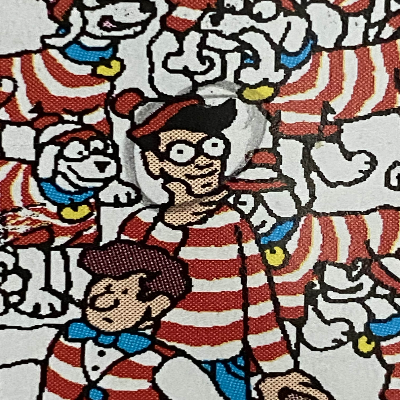

IMG_8960.jpg
(1613, 1210, 3)


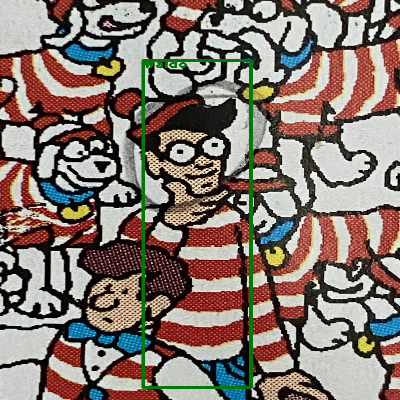

()
()
()
()
()
()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


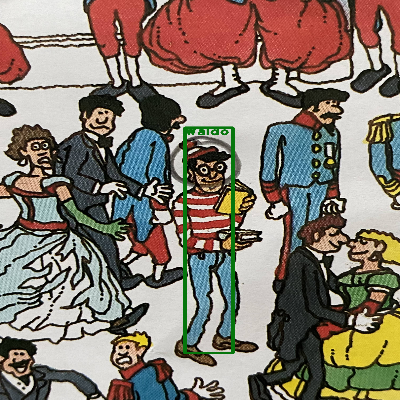

0
[0]
IMG_8945.jpg
(1613, 1210, 3)


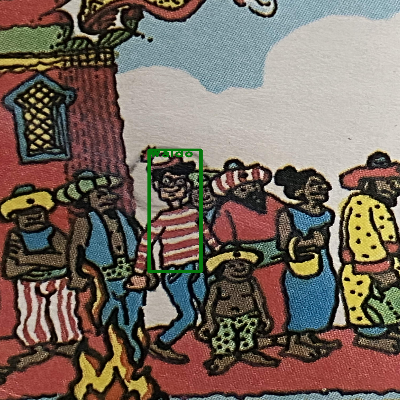

0
[0]
IMG_8945.jpg
(1210, 1613, 3)


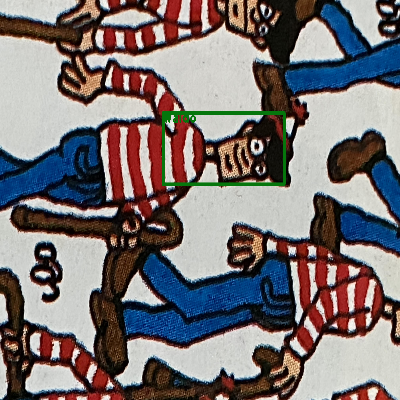

0
[0]
IMG_8945.jpg
(1613, 1210, 3)


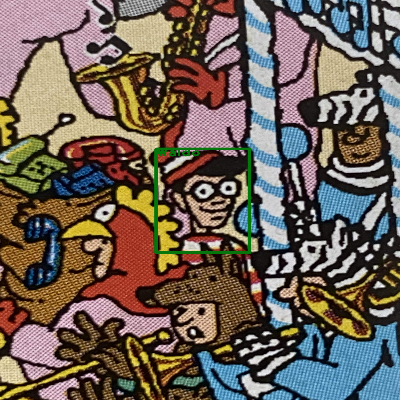

0
()
IMG_8945.jpg
(1613, 1210, 3)


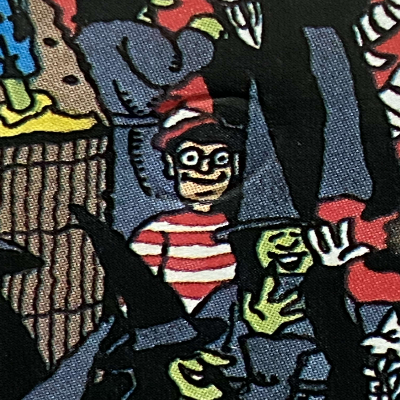

()
()
()
()
0
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


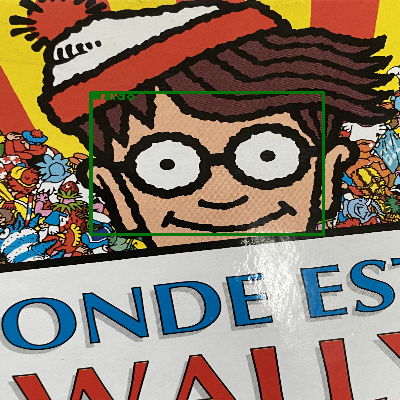

IMG_8960.jpg
(1613, 1210, 3)


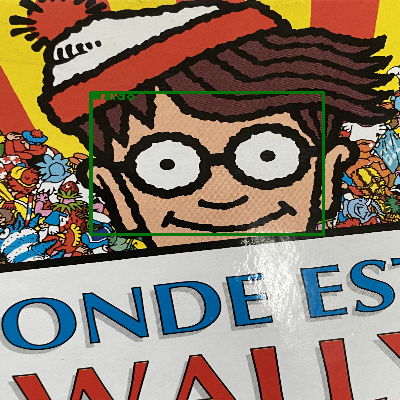

0
[0]
IMG_8945.jpg
(1210, 1613, 3)


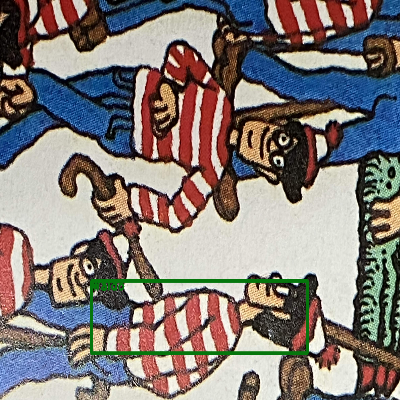

()
()
0
[0]
IMG_8945.jpg
(1210, 1613, 3)


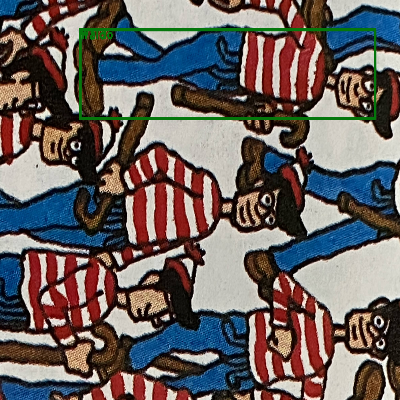

()
0
[0]
IMG_8945.jpg
(1613, 1210, 3)


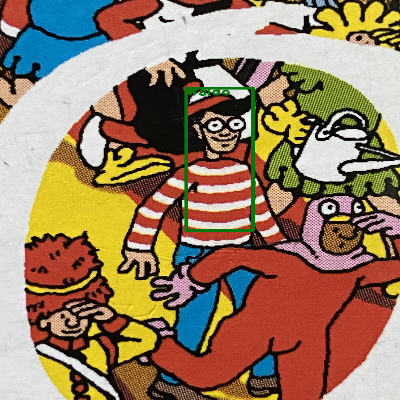

0
0
()
IMG_8945.jpg
(1613, 1210, 3)


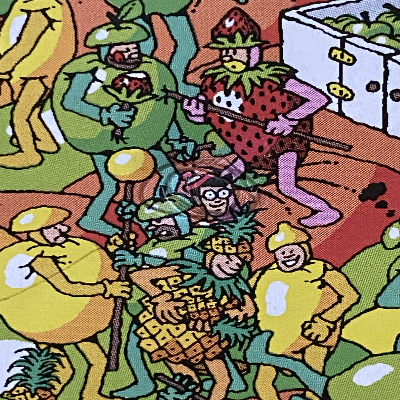

IMG_8960.jpg
(1613, 1210, 3)


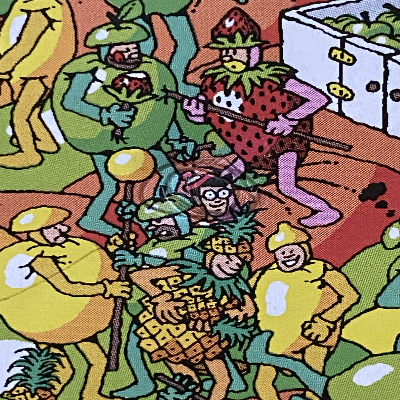

0
0
[1]
IMG_8945.jpg
(1210, 1613, 3)


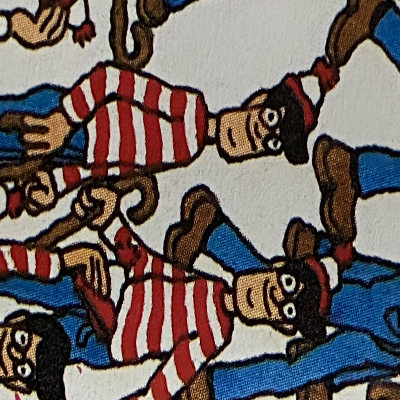

IMG_8960.jpg
(1210, 1613, 3)


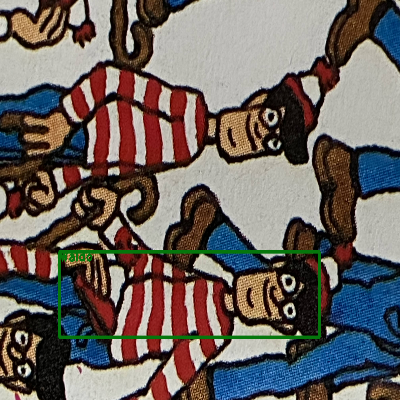

()
()
0
0
[0]
IMG_8945.jpg
(891, 829, 3)


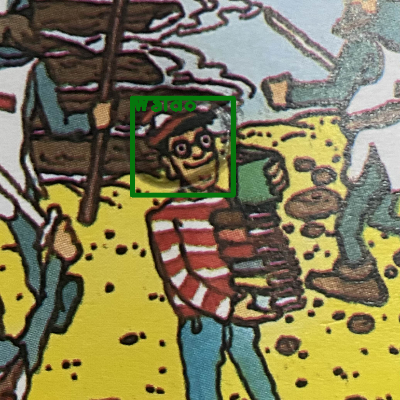

IMG_8960.jpg
(891, 829, 3)


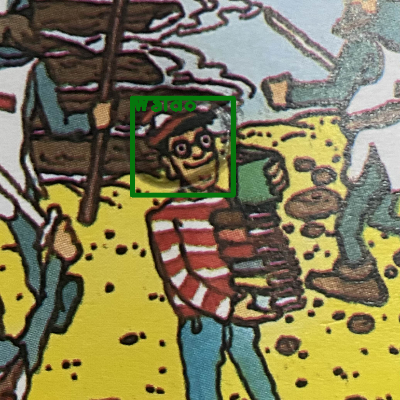

0
[0]
IMG_8945.jpg
(1613, 1210, 3)


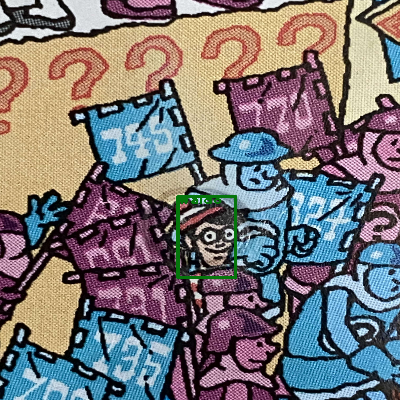

0
[0]
IMG_8945.jpg
(1210, 1613, 3)


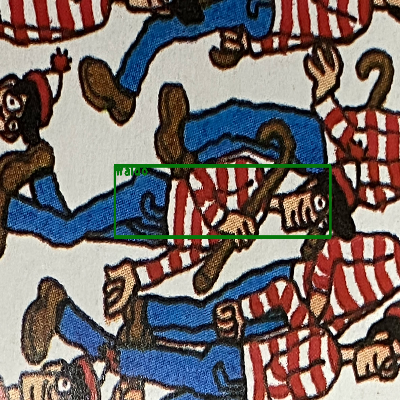

0
[0]
IMG_8945.jpg
(1613, 1210, 3)


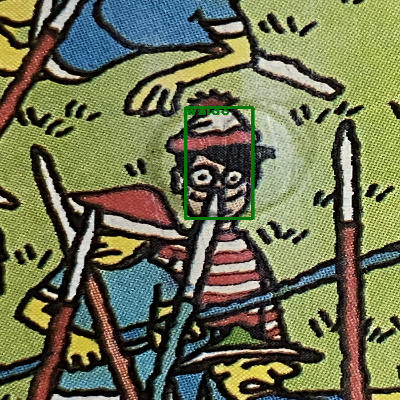

()
0
0
0
[1]
IMG_8945.jpg
(1210, 1613, 3)


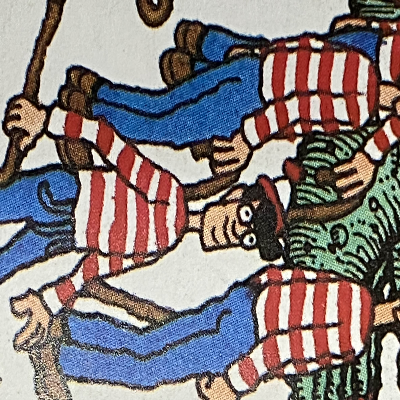

IMG_8960.jpg
(1210, 1613, 3)


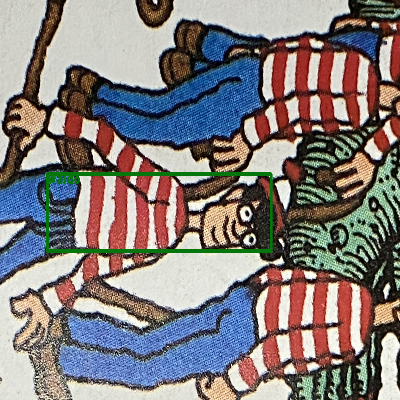

IMG_8957.jpg
(1210, 1613, 3)


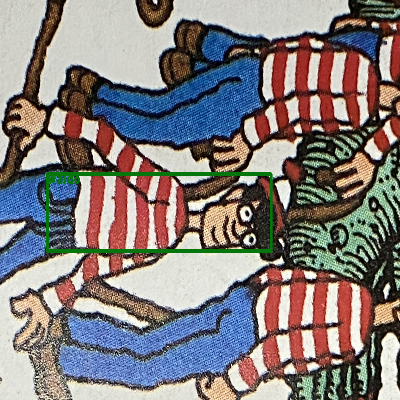

()
()


In [12]:
num_boxes = []
for i in range(0,len(images_path)):
  img_path = os.path.join(base_path, images_path[i])
  # Loading image
  img = cv2.imread(img_path)
  img = cv2.resize(img, None, fx=0.4, fy=0.4)
  height, width, channels = img.shape

  # Detecting objects
  blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

  net.setInput(blob)
  outs = net.forward(output_layers)
  # Detecting objects
  blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

  net.setInput(blob)
  outs = net.forward(output_layers)

  # Showing informations on the screen
  class_ids = []
  confidences = []
  boxes = []
  for out in outs:
    for detection in out:
      scores = detection[5:]
      class_id = np.argmax(scores)
      confidence = scores[class_id]
      if confidence > 0.3:
        # Object detected
        print(class_id)
        center_x = int(detection[0] * width)
        center_y = int(detection[1] * height)
        w = int(detection[2] * width)
        h = int(detection[3] * height)

       # Rectangle coordinates
        x = int(center_x - w / 2)
        y = int(center_y - h / 2)

        boxes.append([x, y, w, h])
        confidences.append(float(confidence))
        class_ids.append(class_id)

  indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
  print(indexes)
  font = cv2.FONT_HERSHEY_PLAIN
  for i in range(len(boxes)):
    if i in indexes:
      x, y, w, h = boxes[i]
      label = str(classes[class_ids[i]])
      color = colors[class_ids[i]]
      cv2.rectangle(img, (x, y), (x + w, y + h), color, 10)
      cv2.putText(img, label, (x, y + 30), font, 3, color, 5)
 
    if len(boxes) > 0:
      num_boxes.append(1)
    else:
      num_boxes.append(0)

 
    print(images_path[i])
    print(img.shape)
    image_resize = cv2.resize(img, (400, 400))
    cv2_imshow(image_resize)
    key = cv2.waitKey(0)

    cv2.destroyAllWindows()


In [16]:
sum(num_boxes)/len(os.listdir(base_path))

0.625